## Setup

In [ ]:
# initialize file system

from google.colab import drive
drive.mount('/content/drive')
%cd
%cd '/content/drive/MyDrive/Colab Notebooks/ethanol-sensor'
filepath = './Interpolated Data Fermentation VHG_055_41_51.xlsx'

Mounted at /content/drive
/root
/content/drive/MyDrive/Colab Notebooks/ethanol-sensor


In [ ]:
!pip install tsgm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.3/65.3 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.1/48.1 kB 6.8 MB/s eta 0:00:00
  Created wheel for tsgm: filename=tsgm-0.0.5-py3-none-any.whl size=57108 sha256=51f3598fd6ab53ec59989ce3c7e64641a8fbc7f43464a29ec02407e614aa349f
  Stored in directory: /root/.cache/pip/wheels/f3/04/27/7d080cdaf3c4a00fc1accf8066ad2581cdd3da04b6b381c411
  Created wheel for antropy: filename=antropy-0.1.6-py3-none-any.whl size=16879 sha256=64d19bbe5da18a114ef5ec38813f54815fe74cb5b6d682389e5a1c4741fee6a2
  Stored in directory: /root/.cache/pip/wheels/98/22/06/e91d7bb213c7133d5e2eb34258623e1e19928d5f05e1

In [ ]:
import numpy as np
import sklearn
import copy
import joblib
import sklearn.model_selection
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import pandas as pd
from sklearn.impute import KNNImputer

import tsgm

In [ ]:
## helper function to convert 3D np.ndarray to 2D pd.DataFrame

def flatten3D(X: np.ndarray, columns: list = ['temp', 'pH', 'redox', 'capac', 'xdb', 'trs', 'ethn', 'sample_num']) -> pd.DataFrame:
  n_samples, n_timesteps, n_columns = X.shape

  # create an index to keep track of generated experiments
  # an nd array with n_timesteps copies of each integer for each of n_samples
  # reshape into (-1, 1) where rows is automatically calculated and 1 column
  sample_ind = np.reshape(np.repeat(np.arange(n_samples), n_timesteps), (n_timesteps * n_samples, 1))

  # flatten generated samples to 2D array
  flatfile = np.reshape(X, (-1, n_columns))

  flatfile_indexed = pd.DataFrame(
      np.concatenate((flatfile, sample_ind), axis = 1),
      columns = columns)
  flatfile_indexed.sample_num = flatfile_indexed.sample_num.astype(int)

  return flatfile_indexed

## Load data from previous notebook

In [ ]:
# load tsgm scaler object
tsscaler = joblib.load('./state_files/tsscaler.ts')

# load original data and generate variants
timeseries_imputed_scaled = joblib.load('./state_files/timeseries_imputed_scaled.data')

timeseries_imputed = timeseries_imputed_scaled.copy()
tsscaler.inverse_transform(timeseries_imputed)

original_flat = flatten3D(timeseries_imputed)
original_flat_scaled = flatten3D(timeseries_imputed_scaled)


# load jittered data and generate variants
jittered_data =joblib.load('./state_files/jittered_data_ndarray.data')

jittered_unscaled = jittered_data.copy()
tsscaler.inverse_transform(jittered_unscaled)

jittered_unscaled_flat = flatten3D(jittered_unscaled)


# load vae data and generate variants
vae_data = joblib.load('./state_files/vae_data_ndarray.data')

vae_data_unscaled = vae_data.numpy().copy()
tsscaler.inverse_transform(vae_data_unscaled)

vae_unscaled_flat = flatten3D(vae_data_unscaled)
vae_scaled_flat = flatten3D(vae_data)


# load gan data and generate variants
gan_data = joblib.load('./state_files/gan_data_ndarray.data')

gan_data_unscaled = gan_data.copy()
tsscaler.inverse_transform(gan_data_unscaled)

gan_unscaled_flat = flatten3D(gan_data_unscaled)
gan_scaled_flat = flatten3D(gan_data)

In [ ]:
# save flattened csv's to disk (already done)
# jittered_unscaled_flat.to_csv('./gaussian_augmented_data_v5_(unscaled).csv')
# vae_unscaled_flat.to_csv('./vae_augmented_data_v1_(unscaled).csv')

## Visualizations

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

In [ ]:
import seaborn as sns
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import matplotlib.cm as cm
import matplotlib.colors as mc

### histograms

In [ ]:
# generate side-by-side histograms for every variable

hist_features = ['temp', 'pH', 'redox', 'capac', 'xdb', 'trs', 'ethn']
hist_dfs = [original_flat, vae_unscaled_flat, jittered_unscaled_flat, gan_unscaled_flat]
hist_df_names = ['original', 'VAE', 'jittered', 'GAN']
plotnames = tuple([variable + ' - ' + df for variable in hist_features for df in hist_df_names])

hist_fig = make_subplots(rows = 7, cols = 4, subplot_titles = plotnames)

for variable in hist_features:
  col_n = 1
  for df in hist_dfs:
    hist_fig.add_trace(go.Histogram(x = df[variable]),
                       row = (hist_features.index(variable) + 1),
                       col =  col_n)
    col_n += 1

hist_fig.update_layout(height=3000, width=1800, title_text="Distributions of Features")
hist_fig.show()

In [ ]:
# generate side-by-side histograms for every variable
# this is a regenerated version for use in the paper. just a different display format and colors.

hist_features = ['pH', 'redox', 'capac', 'temp', 'ethn']
hist_dfs = [original_flat, jittered_unscaled_flat, vae_unscaled_flat, gan_unscaled_flat]
hist_df_names = ['original', 'jittered', 'VAE',  'GAN']
plotnames = tuple([variable + ' - ' + df for df in hist_df_names for variable in hist_features])

hist_fig = make_subplots(rows = 4, cols = 5, subplot_titles = plotnames, vertical_spacing = 0.05, horizontal_spacing = 0.025)
row_n = 1
for df in hist_dfs:

  for variable in hist_features:
    hist_fig.add_trace(go.Histogram(x = df[variable], marker_color='#3b8c6e' if row_n == 1 else '#0eaced'),
                       row = row_n,
                       col =  (hist_features.index(variable) + 1),
                       )
  row_n += 1

hist_fig.update_annotations(font_size=30)
hist_fig.update_layout(height=1800, width=2800, title_text="Distributions of Features", showlegend=False)
hist_fig.show()

Output hidden; open in https://colab.research.google.com to view.

### time series plots

In [ ]:
# manually add a time axis to show time series
original_flat_time = pd.concat((original_flat, pd.DataFrame(np.tile(np.arange(500), 11), columns = ['time'])), axis = 1)
vae_unscaled_flat_time = pd.concat((vae_unscaled_flat, pd.DataFrame(np.tile(np.arange(500), 100), columns = ['time'])), axis = 1)
jittered_unscaled_flat_time = pd.concat((jittered_unscaled_flat, pd.DataFrame(np.tile(np.arange(500), 100), columns = ['time'])), axis = 1)
gan_unscaled_flat_time = pd.concat((gan_unscaled_flat, pd.DataFrame(np.tile(np.arange(500), 100), columns = ['time'])), axis = 1)

In [ ]:
original_flat_time.sample_num = original_flat_time.sample_num.astype(str)
vae_unscaled_flat_time.sample_num = vae_unscaled_flat_time.sample_num.astype(str)

In [ ]:
# show all time series

plot_feat = ['temp', 'pH', 'redox', 'capac', 'ethn', 'trs']
plot_dfs = [original_flat_time, vae_unscaled_flat_time, gan_unscaled_flat_time]

for feature in plot_feat:
  # create a figure with subfigures
  feat_fig = make_subplots(rows = 1, cols = 3, y_title = feature, subplot_titles = ('original', 'VAE', 'GAN'))

  col_n = 1
  for df in plot_dfs:
    fig = px.line(df, x = 'time', y = feature, color = 'sample_num')
    for d in fig.data:
      feat_fig.add_trace(d, row = 1, col = col_n)
    col_n += 1

  feat_fig.show()

In [ ]:
# this makes the same plots as above, but swaps rows and columns. Aspect ratio contstraint design choice only for the powerpoint.

plot_feat = ['temp', 'pH', 'redox', 'capac', 'ethn', 'trs']
plot_dfs = [original_flat_time, vae_unscaled_flat_time, gan_unscaled_flat_time]

for feature in plot_feat:
  # create a figure with subfigures
  feat_fig = make_subplots(rows = 3, cols = 1, y_title = feature, vertical_spacing = 0.025, horizontal_spacing = 0.025)

  row_n = 1
  for df in plot_dfs:
    fig = px.line(df, x = 'time', y = feature, color = 'sample_num')
    for d in fig.data:
      feat_fig.add_trace(d, row = row_n, col = 1)
    row_n += 1

  feat_fig.update_layout(showlegend=False)
  feat_fig.update_layout(height=1500, width=750)
  feat_fig.show()

#### less useful time series plots

<Axes: xlabel='time', ylabel='ethn'>

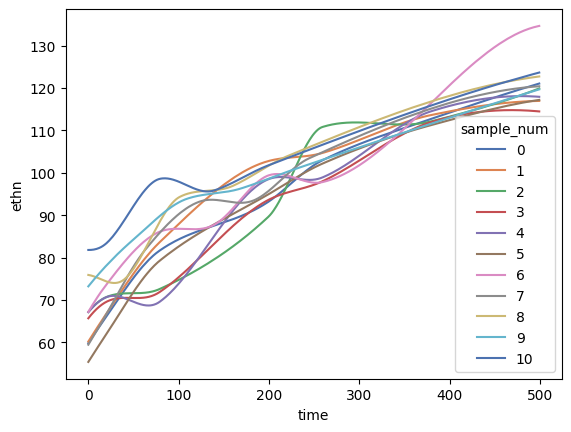

In [ ]:
# ethanol v. time, original, 2D
sns.lineplot(data=original_flat_time, x='time', y='ethn', hue = 'sample_num', palette = 'deep')

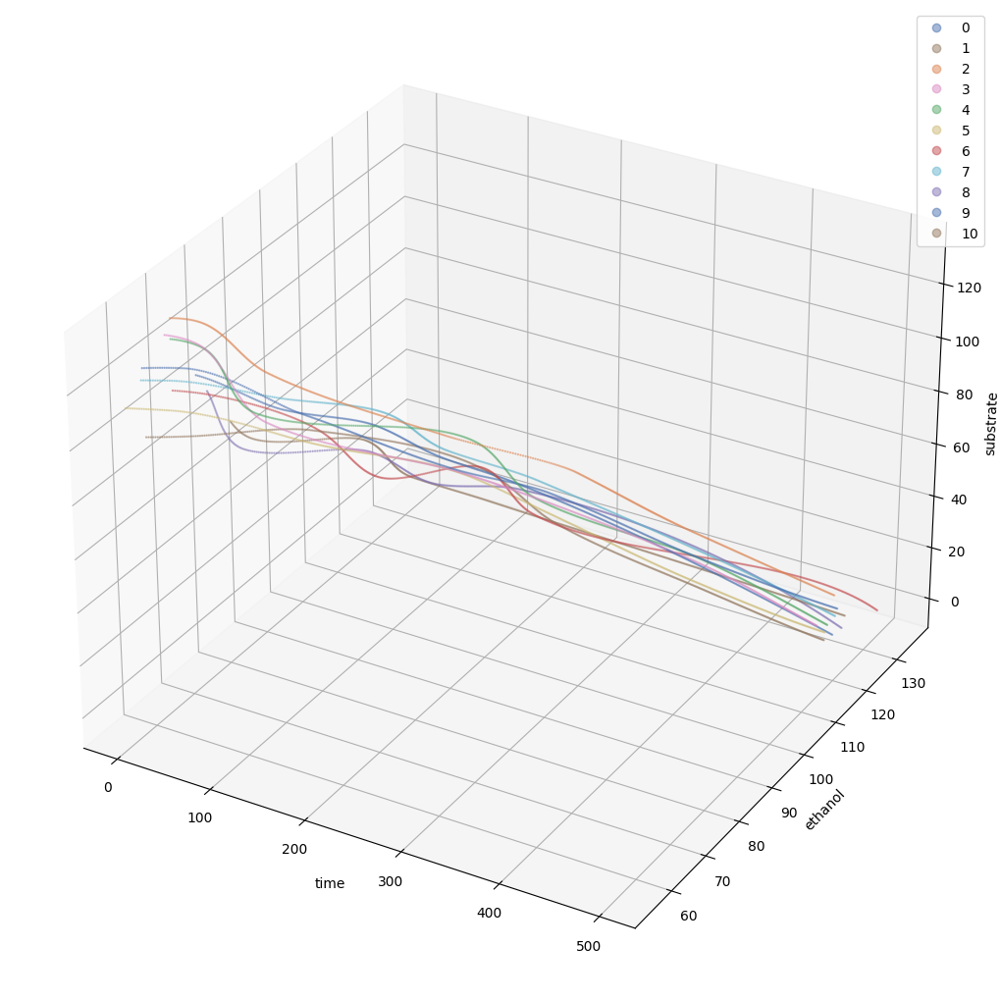

In [ ]:
# ethanol v. substrate v. time, original, 3D static

# axes instance
fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

# get colormap from seaborn
cmap = ListedColormap(sns.color_palette("deep", 256).as_hex())

# plot
sc = ax.scatter(original_flat_time.time, original_flat_time.ethn, original_flat_time.trs, c = original_flat_time.sample_num, cmap=cmap, s = 0.5, alpha=0.5)
ax.set_xlabel('time')
ax.set_ylabel('ethanol')
ax.set_zlabel('substrate')

plt.legend(*sc.legend_elements())

In [ ]:
# ethanol v. substrate v. time, original, 3D interactive

fig = px.scatter_3d(original_flat_time, y='time', x='ethn', z='trs',
                    color='sample_num', opacity = 1,
                    width = 1600, height = 1000,
                    color_discrete_sequence=px.colors.qualitative.Bold)

fig.update_traces(marker={'size': 1})
fig.show()

<Axes: xlabel='time', ylabel='ethn'>

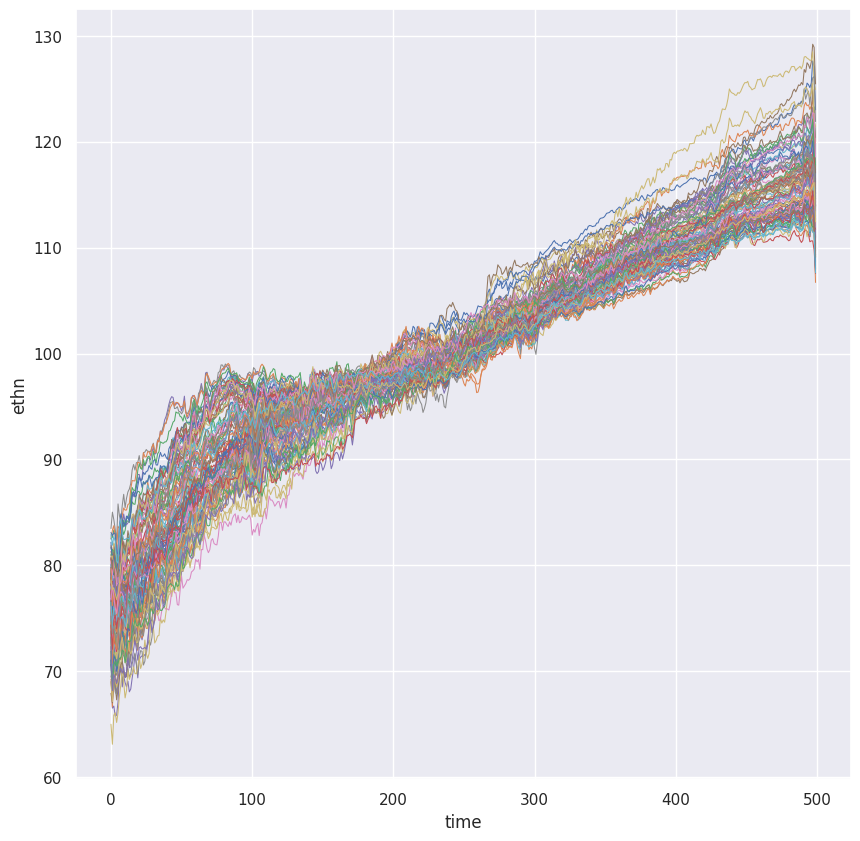

In [ ]:
# ethanol v. time, vae, 2D

sns.set(rc={"figure.figsize":(10, 10)})
sns.lineplot(data=vae_unscaled_flat_time, x='time', y='ethn', hue = 'sample_num', palette = 'deep', size = 0.1, legend = False)

In [ ]:
# ethanol v. substrate v. time, vae, 3D interactive

fig = px.line_3d(vae_unscaled_flat_time, y='time', x='ethn', z='trs',
                    color='sample_num',
                    width = 1600, height = 900,
                    color_discrete_sequence=px.colors.qualitative.Bold)

fig.update_traces(marker={'size': 1})
fig.show()

<Axes: xlabel='time', ylabel='ethn'>

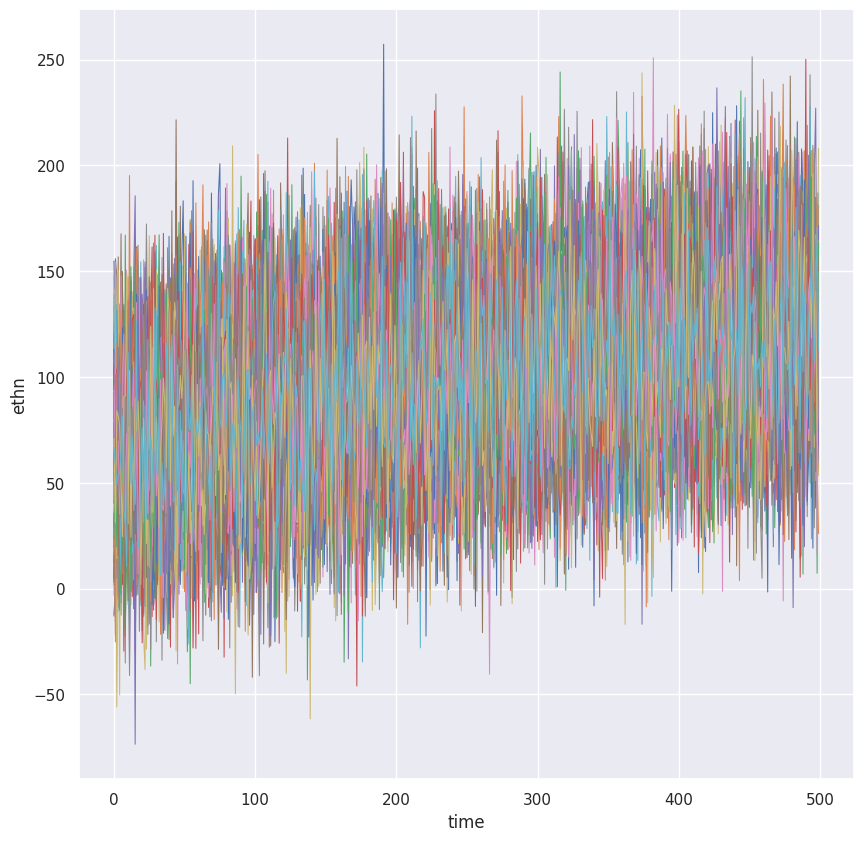

In [ ]:
# ethanol v. time, jittered, 2D

sns.set(rc={"figure.figsize":(10, 10)})
sns.lineplot(data=jittered_unscaled_flat_time, x='time', y='ethn', hue = 'sample_num', palette = 'deep', size = 0.1, legend = False)

In [ ]:
features = ['temp', 'pH', 'redox', 'capac', 'xdb', 'trs', 'ethn']

### t-SNE graphs

In [ ]:
orig_synth_colors = {'hist': colors.to_rgb('#00FF00'),
                      'gen': colors.to_rgb('#27A4F2')}


In [ ]:
sns.set(rc={'axes.facecolor':colors.to_rgb('#ffffff'), 'figure.facecolor':colors.to_rgb('#ffffff')})

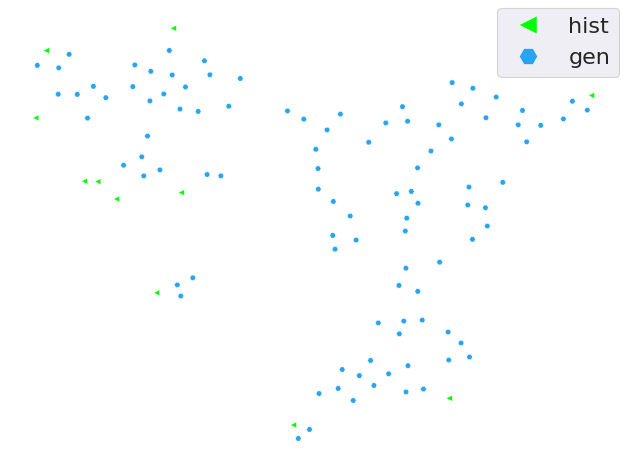

In [ ]:
# vae
tsgm.utils.visualize_tsne_unlabeled(timeseries_imputed_scaled, vae_data, perplexity=15, markersize=30, alpha= 1, palette = orig_synth_colors)

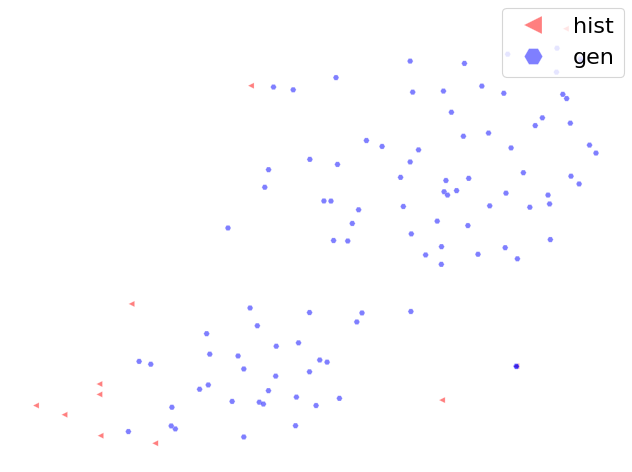

In [ ]:
# vae
tsgm.utils.visualize_tsne_unlabeled(timeseries_imputed, vae_data_unscaled, perplexity=40, markersize=30, alpha=0.5)

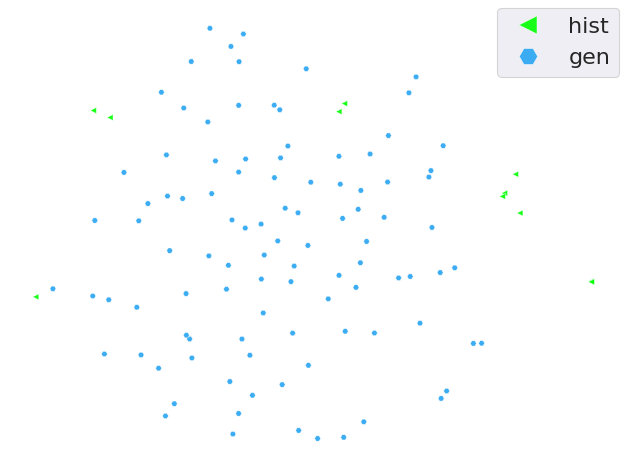

In [ ]:
# gan
tsgm.utils.visualize_tsne_unlabeled(timeseries_imputed_scaled, gan_data, perplexity=15, markersize=30, alpha= 0.9, palette = orig_synth_colors)

## Regression setup

In [ ]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

In [ ]:
# split data
X_orig = original_flat_scaled[['temp', 'pH', 'redox', 'capac']]
Y_orig = original_flat_scaled['ethn']
X_orig_train, X_orig_test, Y_orig_train, Y_orig_test = train_test_split(X_orig, Y_orig, test_size = 0.2, random_state = 5)

In [ ]:
def rsquare(model, X_train = X_orig_train, X_test = X_orig_test, y_train = Y_orig_train, y_test = Y_orig_test):
  train_pred = model.predict(X_train)
  val_pred = model.predict(X_test)

  train_r2 = r2_score(y_train, train_pred)
  test_r2 = r2_score(y_test, val_pred)
  print(f'train r-square: {train_r2:.2f}')
  print(f'test r-square: {test_r2:.2f}')

  return train_r2, test_r2

In [ ]:
def calc_rmse(model, X_train = X_orig_train, X_test = X_orig_test, y_train = Y_orig_train, y_test = Y_orig_test):
  train_pred = model.predict(X_train)
  val_pred = model.predict(X_test)

  train_rmse = mean_squared_error(y_train, train_pred, squared = False)
  test_rmse = mean_squared_error(y_test, val_pred, squared = False)
  print(f'train rmse: {train_rmse:.5f}')
  print(f'test rmse: {test_rmse:.5f}')

  return train_rmse, test_rmse

## Regression model

This is the first (preliminary testing) attempt at building regression models. We eventually used the architecture for model 2.

In [ ]:
model1 = Sequential([
    Dense(80, activation = 'relu'),
    Dense(1)
])

model1.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

In [ ]:
history1 = model1.fit(X_orig_train, Y_orig_train, epochs = 150, validation_data = (X_orig_test, Y_orig_test))

Epoch 1/150
138/138 [==============================] - 1s 2ms/step - loss: 0.0277 - mean_squared_error: 0.0277 - val_loss: 0.0080 - val_mean_squared_error: 0.0080
Epoch 2/150
138/138 [==============================] - 0s 2ms/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 3/150
138/138 [==============================] - 0s 1ms/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 4/150
138/138 [==============================] - 0s 1ms/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 5/150
138/138 [==============================] - 0s 1ms/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 6/150
138/138 [==============================] - 0s 1ms/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 7/150
138/138 [=

In [ ]:
rsquare(model1)


14/14 [==============================] - 0s 1ms/step
train r-square: 0.79
test r-square: 0.79


In [ ]:
model2 = Sequential([
    Dense(80, activation = 'relu'),
    Dense(60, activation = 'relu'),
    # Dense(10, activation = 'relu'),
    Dense(1)
])

model2.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

In [ ]:
history2 = model2.fit(X_orig_train, Y_orig_train, epochs = 150, validation_data = (X_orig_test, Y_orig_test))

Epoch 1/150
55/55 [==============================] - 1s 4ms/step - loss: 0.0164 - mean_squared_error: 0.0164 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 2/150
55/55 [==============================] - 0s 2ms/step - loss: 0.0022 - mean_squared_error: 0.0022 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 3/150
55/55 [==============================] - 0s 2ms/step - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 4/150
55/55 [==============================] - 0s 2ms/step - loss: 0.0020 - mean_squared_error: 0.0020 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 5/150
55/55 [==============================] - 0s 2ms/step - loss: 0.0016 - mean_squared_error: 0.0016 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 6/150
55/55 [==============================] - 0s 1ms/step - loss: 0.0014 - mean_squared_error: 0.0014 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 7/150
55/55 [===============

In [ ]:
rsquare(model2)

14/14 [==============================] - 0s 1ms/step
train r-square: 0.95
test r-square: 0.96


Note: the results from these following cells are probably meaningless. We initially did the train/test splits randomly by throwing all the data into one big pot, irrespective of individual experiments, then split the data, but this means that there is representation from all experiments in the training set, and thus is probably not a valid way to see if the model can generalize to new experiments. We change this methodology to splitting by experiments in the section labeled "cross validation."

In [ ]:
X_vae = vae_scaled_flat[['temp', 'pH', 'redox', 'capac']]
Y_vae = vae_scaled_flat['ethn']

In [ ]:
history3 = model2.fit(X_vae, Y_vae, epochs = 100, validation_data = (X_orig, Y_orig))

Epoch 1/100
1563/1563 [==============================] - 2s 1ms/step - loss: 0.0017 - mean_squared_error: 0.0017 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 2/100
1563/1563 [==============================] - 2s 1ms/step - loss: 6.8039e-04 - mean_squared_error: 6.8039e-04 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 3/100
1563/1563 [==============================] - 2s 1ms/step - loss: 6.3451e-04 - mean_squared_error: 6.3451e-04 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 4/100
1563/1563 [==============================] - 2s 2ms/step - loss: 5.5280e-04 - mean_squared_error: 5.5280e-04 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 5/100
1563/1563 [==============================] - 2s 1ms/step - loss: 5.2897e-04 - mean_squared_error: 5.2897e-04 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 6/100
1563/1563 [==============================] - 2s 1ms/step - loss: 5.1717e-04 - mean_squared_error: 5.1717e-04 - val_loss: 0.0056 - v

In [ ]:
rsquare(model2, X_vae, X_orig, Y_vae, Y_orig)

172/172 [==============================] - 0s 1ms/step
train r-square: 0.98
test r-square: 0.89


In [ ]:
model2_gan = Sequential([
    Dense(80, activation = 'relu'),
    Dense(60, activation = 'relu'),
    Dense(1)
])

model2_gan.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

In [ ]:
X_gan = gan_scaled_flat[['temp', 'pH', 'redox', 'capac']]
Y_gan = gan_scaled_flat['ethn']

In [ ]:
history4 = model2_gan.fit(X_gan, Y_gan, epochs = 100, validation_data = (X_orig, Y_orig))

Epoch 1/100
1563/1563 [==============================] - 10s 5ms/step - loss: 0.0030 - mean_squared_error: 0.0030 - val_loss: 0.0074 - val_mean_squared_error: 0.0074
Epoch 2/100
1563/1563 [==============================] - 6s 4ms/step - loss: 0.0015 - mean_squared_error: 0.0015 - val_loss: 0.0125 - val_mean_squared_error: 0.0125
Epoch 3/100
1563/1563 [==============================] - 5s 3ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - val_loss: 0.0135 - val_mean_squared_error: 0.0135
Epoch 4/100
1563/1563 [==============================] - 3s 2ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - val_loss: 0.0141 - val_mean_squared_error: 0.0141
Epoch 5/100
1563/1563 [==============================] - 3s 2ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - val_loss: 0.0127 - val_mean_squared_error: 0.0127
Epoch 6/100
1563/1563 [==============================] - 5s 3ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - val_loss: 0.0123 - val_mean_squared_error: 0.0123
Epoch 7/1

In [ ]:
rsquare(model2_gan, X_gan, X_orig, Y_gan, Y_orig)

172/172 [==============================] - 0s 2ms/step
train r-square: 0.98
test r-square: 0.57


In [ ]:
X_vae.describe()

In [ ]:
X_orig.describe()

## multi-fold CV w/o regard to experiments?

As mentioned previously, these results are also probably meaningless. We cannot meaninfully test the model when the data is train/test split without regard for experiments.

In [ ]:
r2_list_orig_indiv = []
rmse_list_orig_indiv = []

for i in range(100):
  X_orig_train_cross_indiv, X_orig_test_cross_indiv, Y_orig_train_cross_indiv, Y_orig_test_cross_indiv = train_test_split(X_orig, Y_orig, test_size = 0.2)

  model2_orig_indiv = Sequential([
    Dense(80, activation = 'relu'),
    Dense(60, activation = 'relu'),
    Dense(1)
  ])

  model2_orig_indiv.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

  model2_orig_indiv.fit(X_orig_train_cross_indiv, Y_orig_train_cross_indiv, epochs = 150, validation_data = (X_orig_test_cross_indiv, Y_orig_test_cross_indiv), verbose = 0)

  train_r2, test_r2 = rsquare(model2_orig_indiv, X_orig_train_cross_indiv, X_orig_test_cross_indiv, Y_orig_train_cross_indiv, Y_orig_test_cross_indiv)
  train_rmse, test_rmse = rmse(model2_orig_indiv, X_orig_train_cross_indiv, X_orig_test_cross_indiv, Y_orig_train_cross_indiv, Y_orig_test_cross_indiv)

  r2_list_orig_indiv.append(test_r2)
  rmse_list_orig_indiv.append(test_rmse)


35/35 [==============================] - 0s 2ms/step
train r-square: 0.99
test r-square: 0.99
35/35 [==============================] - 0s 2ms/step
train rmse: 0.02
test rmse: 0.02
35/35 [==============================] - 0s 2ms/step
train r-square: 0.99
test r-square: 0.99
35/35 [==============================] - 0s 2ms/step
train rmse: 0.02
test rmse: 0.02
35/35 [==============================] - 0s 2ms/step
train r-square: 0.99
test r-square: 0.98
35/35 [==============================] - 0s 2ms/step
train rmse: 0.02
test rmse: 0.03
35/35 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: 0.97
35/35 [==============================] - 0s 2ms/step
train rmse: 0.03
test rmse: 0.03
35/35 [==============================] - 0s 2ms/step
train r-square: 0.99
test r-square: 0.99
35/35 [==============================] - 0s 2ms/step
train rmse: 0.02
test rmse: 0.02
35/35 [==============================] - 0s 3ms/step
train r-square: 0.99
test r-square: 0.99
35/35 

In [ ]:
r2_list_orig_indiv

[0.9854358498339081,
 0.987304980357363,
 0.9849477965601933,
 0.9706273157521059,
 0.9893474045576504,
 0.9888880480911645,
 0.9821700361820542,
 0.9869515666615213,
 0.9875378505783323,
 0.9886177094040816,
 0.9865619886188596,
 0.9891326532386411,
 0.9873224722853983,
 0.9848339191900265,
 0.9878791266750552,
 0.9858174994840114,
 0.9880206179592201,
 0.9837919754815247,
 0.983846470811382,
 0.9868855938118631,
 0.9857736271788929,
 0.9886807567583393,
 0.9790773973435924,
 0.9856396089159873,
 0.9798726108034702,
 0.9865224796858729,
 0.9779488414063616,
 0.9758961150830784,
 0.985462949660471,
 0.9900243036293889,
 0.9846475397094733,
 0.9872129907343443,
 0.9887943395226809,
 0.9904793181204951,
 0.9849536901659167,
 0.9782289027036131,
 0.9866864424037182,
 0.9888015888917612,
 0.9889177503206347,
 0.9777100593875903,
 0.9887532129090121,
 0.9873169138362705,
 0.9847915668419894,
 0.9828206239705765,
 0.9828820488072778,
 0.9812394753502589,
 0.9856053885472901,
 0.9840678794902

In [ ]:
rmse_list_orig_indiv

[0.024013028696469773,
 0.02223299324637901,
 0.025134262923636647,
 0.03298333964722991,
 0.02098628013843224,
 0.021239387059799247,
 0.02701148292206492,
 0.022653580808097692,
 0.021797164849321166,
 0.02146785350763104,
 0.023316613337460705,
 0.020777814209064067,
 0.02284765218764556,
 0.025314152488947406,
 0.022562743175014204,
 0.023791661726418657,
 0.022592076640499812,
 0.02515818279510349,
 0.02578908753469444,
 0.023779775321385813,
 0.023510908015883826,
 0.021698251807732934,
 0.029026162323366713,
 0.02432981830467293,
 0.028073318848471005,
 0.023408898287128756,
 0.029372641366228833,
 0.03137897505747345,
 0.023749608451210248,
 0.02075548271609667,
 0.024512457293328876,
 0.023594890082475686,
 0.021075997506428946,
 0.019594684752626434,
 0.024368516868291175,
 0.029560275082984637,
 0.023373498385488033,
 0.021714324187215677,
 0.02178824906233689,
 0.02976218300109162,
 0.021385298212187674,
 0.022365456817209715,
 0.024321210674804857,
 0.026515532339030184,
 

## cross validation

In this section we use the methodology described in the paper with random sampling by experiment.

In [ ]:
import random
set_list = list(range(11))

In [ ]:
import seaborn as sns
import matplotlib.colors as colors
import matplotlib.pyplot as plt
sns.set(rc={'figure.figsize':(10,5)})

In [ ]:
# function for running one iteration of random split, train, and test

def crossfold_set(df: pd.DataFrame, train_list: list, test_list: list):
  train = df[df.sample_num.isin(train_list)]
  test = df[df.sample_num.isin(test_list)]

  X_train_cross = train[['temp', 'pH', 'redox', 'capac']]
  y_train_cross = train['ethn']

  X_test_cross = test[['temp', 'pH', 'redox', 'capac']]
  y_test_cross = test['ethn']

  model2_fold = Sequential([
    Dense(80, activation = 'relu'),
    Dense(60, activation = 'relu'),
    Dense(1)
  ])

  model2_fold.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

  history_fold = model2_fold.fit(X_train_cross, y_train_cross, epochs = 100, batch_size = 1024, validation_data = (X_test_cross, y_test_cross), verbose = 0)

  train_r2, test_r2 = rsquare(model2_fold, X_train_cross, X_test_cross, y_train_cross, y_test_cross)
  train_rmse, test_rmse = calc_rmse(model2_fold, X_train_cross, X_test_cross, y_train_cross, y_test_cross)
  return test_r2, test_rmse


In [ ]:
# function for calculating descriptive stats on the r-squared and rmse distribution

def repeated_samples_stats(r2_list: list, rmse_list: list, color: str):
  print(f"mean r2: {np.mean(r2_list)}")
  print(f"r2 std. dev.: {np.std(r2_list, ddof = 1)}")
  print("r2 distrubution:")
  sns.histplot(r2_list, color = colors.to_rgb(color), binrange = (-3.5,1), kde = True)
  plt.ylim(0, 30)
  plt.show()

  print(f'\n\nmean rmse: {np.mean(rmse_list)}')
  print(f"rmse std. dev.: {np.std(rmse_list, ddof = 1)}")
  print("rmse distribution:")
  sns.histplot(rmse_list, color = colors.to_rgb(color), binrange = (0, 0.4), kde = True)
  plt.ylim(0, 30)
  plt.show()


In [ ]:
# function for calculating comparisons between distributions.
# colab will yell at you if you don't run the cells that initialize and populate the r-squared and rmse lists for the original model,
# but I've put this cell here for continuity of setup cells.

import scipy.stats as stats

def compare_samples_stats(r2_list_new: list, rmse_list_new: list, r2_list_old = r2_test_list, rmse_list_old = rmse_test_list):
  print(f'change in r2 mean: {(np.mean(r2_list_new) - np.mean(r2_list_old)) / np.mean(r2_list_old)}')
  print(f'change in r2 std. dev: {(np.std(r2_list_new, ddof=1) - np.std(r2_list_old, ddof=1)) / np.std(r2_list_old, ddof=1)}')
  print(f't-test for r2: {stats.ttest_ind(r2_list_new, r2_list_old, equal_var = False)}')
  print(f'levene test for r2: {stats.levene(r2_list_new, r2_list_old)}')


  print(f'\n\nchange in rmse mean: {(np.mean(rmse_list_new) - np.mean(rmse_list_old)) / np.mean(rmse_list_old)}')
  print(f'change in rmse std. dev: {(np.std(rmse_list_new, ddof=1) - np.std(rmse_list_old, ddof=1)) / np.std(rmse_list_old, ddof=1)}')
  print(f't-test for rmse: {stats.ttest_ind(rmse_list_new, rmse_list_old, equal_var = False)}')
  print(f'levene test for rmse: {stats.levene(rmse_list_new, rmse_list_old)}')



### original

In [ ]:
n_folds = 100
r2_test_list = []
rmse_test_list = []

for i in range(n_folds):
  random.shuffle(set_list)

  print(f'fold: {i}')
  train_list = set_list[:10]
  test_list = set_list[10:]
  print(f'train sets: {train_list}')
  print(f'test sets: {test_list}')

  r2, rmse_score = crossfold_set(original_flat_scaled, train_list, test_list)

  r2_test_list.append(r2)
  rmse_test_list.append(rmse_score)


fold: 0
train sets: [8, 2, 1, 7, 3, 4, 5, 0, 9, 10]
test sets: [6]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: 0.82
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03665
test rmse: 0.09368
fold: 1
train sets: [10, 2, 5, 6, 9, 7, 0, 8, 1, 3]
test sets: [4]
16/16 [==============================] - 0s 3ms/step
train r-square: 0.96
test r-square: 0.85
16/16 [==============================] - 0s 3ms/step
train rmse: 0.04148
test rmse: 0.08520
fold: 2
train sets: [10, 8, 2, 1, 5, 4, 3, 9, 6, 0]
test sets: [7]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.95
test r-square: 0.93
16/16 [==============================] - 0s 2ms/step
train rmse: 0.04330
test rmse: 0.05107
fold: 3
train sets: [7, 8, 0, 9, 1, 10, 3, 4, 2, 6]
test sets: [5]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.95
test r-square: 0.95
16/16 [==============================] - 0s 2ms/step
train rmse: 0.04518
test rm

In [ ]:
r2_test_list

[0.8193735465188939,
 0.8494246282682623,
 0.9334909772815343,
 0.9507356389716567,
 0.7719243461949363,
 0.8926857581863356,
 0.7789603274129798,
 0.9216898934921208,
 0.9521022182091249,
 0.8248909570122713,
 0.8364812865799846,
 -3.4865816697655188,
 0.7643958866084106,
 0.8837714177827112,
 0.835639724723205,
 0.8662746656756888,
 0.9332427685715745,
 0.8764690771197041,
 -2.470142857787248,
 0.954215730833016,
 0.9495261364906892,
 0.7257393095611063,
 0.7391938342423219,
 0.8177072638634408,
 0.923262643523132,
 0.6736046379057348,
 0.8033007394779601,
 0.6646153141635224,
 0.8970676806743245,
 0.9073386050455481,
 0.9269247305905602,
 0.8404482015532782,
 0.9493203886140825,
 -2.0007031632657855,
 0.7919089027053241,
 -1.0601150299770152,
 0.9103616052849871,
 0.8727291217567454,
 0.7321958105616044,
 0.9050794921613536,
 0.856134115360488,
 0.7076263376088607,
 0.7671954271687114,
 0.8718223134366523,
 0.5690445518170633,
 0.7966543900281067,
 0.8526134279677874,
 0.93196019102

In [ ]:
rmse_test_list

[0.09368343839330756,
 0.08519935595599507,
 0.05106832048355754,
 0.04588634744641187,
 0.09039566130438621,
 0.06686741686600148,
 0.08899041587077969,
 0.0554140891809522,
 0.0452454344470391,
 0.0854161815695892,
 0.08878570969992955,
 0.38820251991826293,
 0.06809713560038497,
 0.07485413738468791,
 0.08275310454213909,
 0.06921734999380606,
 0.05341536750076833,
 0.0771697659058038,
 0.3414084283737594,
 0.04423593438177171,
 0.04644621589705956,
 0.0734715484012686,
 0.07164672399673395,
 0.09411456219333567,
 0.05485480923081154,
 0.11697632852188103,
 0.06222125602888474,
 0.08124731623037598,
 0.06072730405186413,
 0.060278260211582724,
 0.05588590326554313,
 0.07560647213165357,
 0.04654078455969857,
 0.3174768622782977,
 0.08634453841434268,
 0.2630548398555916,
 0.05928684330333175,
 0.07832923054418806,
 0.10595822637796633,
 0.06100863644449963,
 0.07742206950794006,
 0.0758588988150611,
 0.09132798490818124,
 0.0786077841526329,
 0.14977292715882234,
 0.0661941979023810

mean r2: 0.6366781234409693
r2 std. dev.: 0.7367257309510902
r2 distrubution:


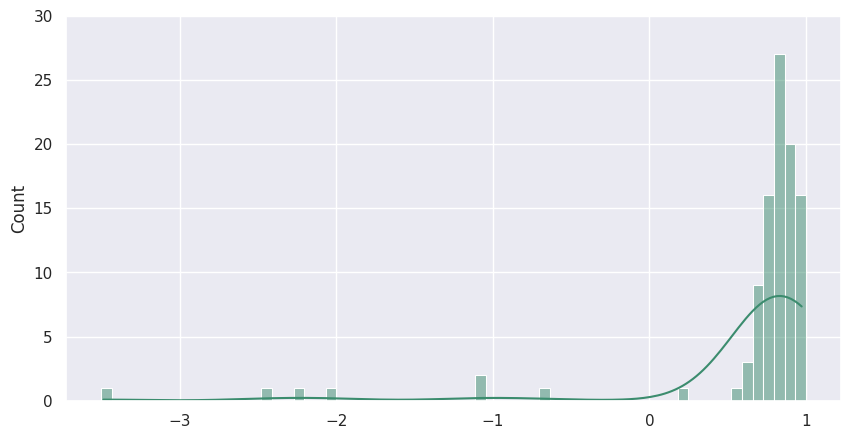



mean rmse: 0.09218869255903084
rmse std. dev.: 0.06448782018007801
rmse distribution:


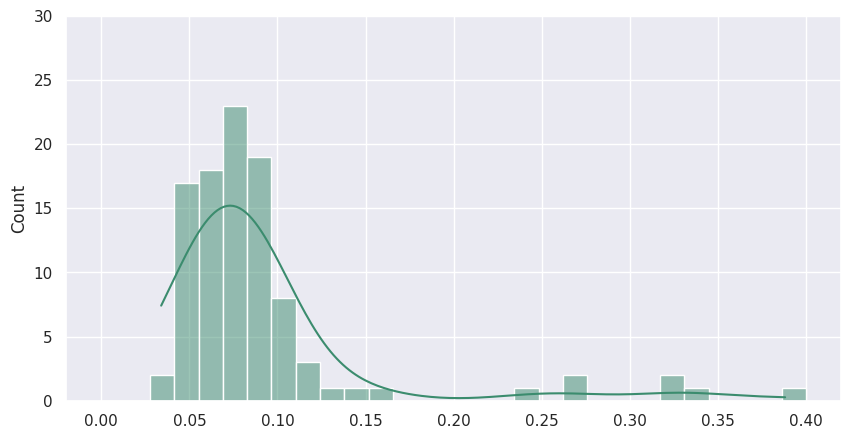

In [ ]:
repeated_samples_stats(r2_test_list, rmse_test_list, '#3B8C6E')

### synthetic (vae)

I've used the word "combined" in the variables which is bad terminology, but oh well, I'm not going to change it. the dataset is combined in the sense that it contains both the original and synthetic data, but in this section, the model is trained on synthetic data only.

In [ ]:
# run on combined vae and original data
vae_renumbered = vae_scaled_flat.copy()
vae_renumbered.sample_num = vae_renumbered.sample_num + 11

vae_plus_orig = pd.concat([original_flat_scaled, vae_renumbered])


In [ ]:
orig_list = list(range(11))
vae_list = list(range(11,111))

n_folds = 100
r2_test_list_combined = []
rmse_test_list_combined = []

for fold in range(n_folds):
  random.shuffle(orig_list)
  random.shuffle(vae_list)

  print(f'fold: {fold}')
  train_list = vae_list[:20]
  test_list = orig_list[:1]
  print(f'train sets: {train_list}')
  print(f'test sets: {test_list}')

  r2, rmse_score = crossfold_set(vae_plus_orig, train_list, test_list)

  r2_test_list_combined.append(r2)
  rmse_test_list_combined.append(rmse_score)


fold: 0
train sets: [31, 22, 61, 96, 15, 29, 33, 90, 91, 92, 32, 50, 104, 26, 108, 43, 78, 44, 16, 13]
test sets: [5]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: 0.91
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02463
test rmse: 0.06276
fold: 1
train sets: [15, 82, 57, 59, 35, 89, 17, 34, 76, 37, 100, 71, 18, 66, 46, 80, 48, 55, 96, 33]
test sets: [8]
16/16 [==============================] - 0s 3ms/step
train r-square: 0.97
test r-square: 0.84
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02214
test rmse: 0.07306
fold: 2
train sets: [64, 41, 34, 25, 53, 44, 80, 22, 90, 33, 95, 65, 96, 14, 16, 18, 57, 91, 93, 97]
test sets: [8]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: -0.02
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02313
test rmse: 0.18550
fold: 3
train sets: [110, 30, 74, 45, 21, 46, 12, 99, 34, 80, 51, 89, 31, 96, 44, 72, 86, 

In [ ]:
r2_test_list_combined

[0.9078478643302548,
 0.8410948769195379,
 -0.024421971278127286,
 0.6696858514380074,
 0.68596641611073,
 0.9150067303162143,
 0.9628341107891089,
 0.5880526613103498,
 0.5324636261473368,
 0.7838429978004638,
 0.9231675513098183,
 0.9319466016241834,
 0.8042040952746083,
 0.7560982393919202,
 0.7917268654902442,
 0.5932158104125167,
 0.9443910295032719,
 0.9082632966972034,
 0.9139509061557366,
 0.7741672268334278,
 0.9250912408415388,
 0.7979649184705837,
 0.6805880526189172,
 0.9083200973531851,
 0.917542640505199,
 0.6630812839541277,
 0.7149143925229748,
 0.693911456313465,
 0.651848460298011,
 0.8820621094081059,
 0.9261287470246373,
 0.8974262471771044,
 0.8864316482459617,
 0.8464873971216108,
 0.8830769857678209,
 0.6986832624284778,
 0.8991582119443283,
 0.6722557158227818,
 0.6203547847767674,
 0.719144986891916,
 0.6525571933615617,
 0.7004464370316951,
 0.9196486206167667,
 0.9739404047107011,
 0.6843028207101771,
 0.852112771674995,
 0.728637544704095,
 0.893904176987175

In [ ]:
rmse_test_list_combined

[0.06275809675875174,
 0.07305829133592603,
 0.1854983297594028,
 0.08063080549518725,
 0.07861862752792229,
 0.05518237528491428,
 0.035332374523664674,
 0.1464326698387773,
 0.10037145636627173,
 0.095194235641927,
 0.05657938245149172,
 0.05750386730069067,
 0.0649537643740738,
 0.06928590240913768,
 0.10411990341719854,
 0.11689140904990403,
 0.04463551494916322,
 0.06261647662964016,
 0.05808773501951358,
 0.09730148770606338,
 0.051805327506680925,
 0.08507883132349359,
 0.11571817481218469,
 0.05731195111661452,
 0.05262780696335168,
 0.13242796289634598,
 0.10932352914941865,
 0.12622363053751143,
 0.12081202304843261,
 0.0783508672392215,
 0.059911456422226575,
 0.06062143947267372,
 0.06673289309570546,
 0.05751412822475583,
 0.07537410111161388,
 0.07701033957776847,
 0.06288275502874835,
 0.11721779834187152,
 0.14057435364948048,
 0.12090888607875093,
 0.0826949658961453,
 0.12017014483799235,
 0.051951396905321835,
 0.029585873411594382,
 0.07882659386723309,
 0.076151178

mean r2: 0.8059461293751795
r2 std. dev.: 0.15132101830174124
r2 distrubution:


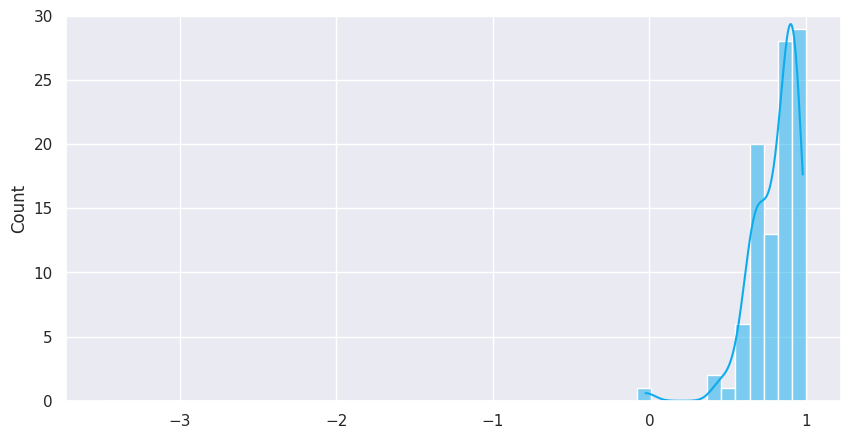



mean rmse: 0.07891122415079184
rmse std. dev.: 0.029854922280244656
rmse distribution:


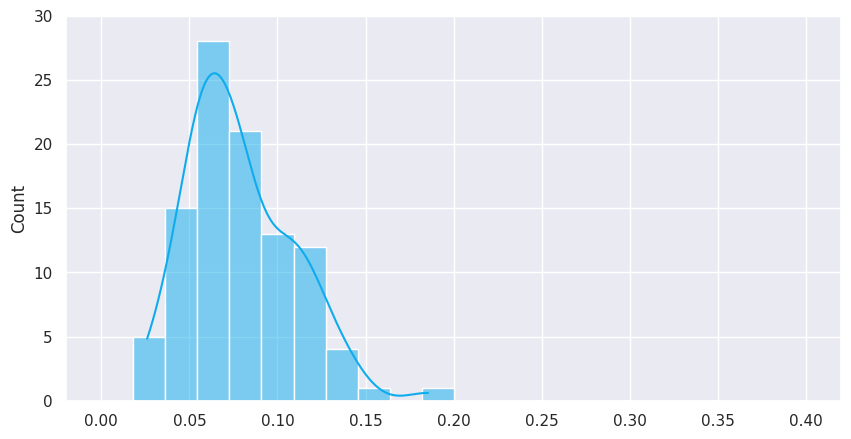

In [ ]:
repeated_samples_stats(r2_test_list_combined, rmse_test_list_combined, '#0EACED')

In [ ]:
compare_samples_stats(r2_test_list_combined, rmse_test_list_combined)

change in r2 mean: 0.2658611937526454
change in r2 std. dev: -0.794603321230018
t-test for r2: TtestResult(statistic=2.2505882550350997, pvalue=0.026450002361469504, df=107.33834287177302)
levene test for r2: LeveneResult(statistic=4.267867892709542, pvalue=0.04014156019005727)


change in rmse mean: -0.1440249128138691
change in rmse std. dev: -0.5370455661723913
t-test for rmse: TtestResult(statistic=-1.8683996972596335, pvalue=0.06380264983551744, df=139.5729497158478)
levene test for rmse: LeveneResult(statistic=2.326443035222692, pvalue=0.12878792592016916)


### blend

In [ ]:
orig_list = list(range(11))
vae_list = list(range(11,111))

n_folds = 100
r2_test_list_blend = []
rmse_test_list_blend = []

for fold in range(n_folds):
  random.shuffle(orig_list)
  random.shuffle(vae_list)

  print(f'fold: {fold}')
  train_list = vae_list[:10] + orig_list[1:]
  test_list = orig_list[:1]
  print(f'train sets: {train_list}')
  print(f'test sets: {test_list}')

  r2, rmse_score = crossfold_set(vae_plus_orig, train_list, test_list)

  r2_test_list_blend.append(r2)
  rmse_test_list_blend.append(rmse_score)

fold: 0
train sets: [65, 17, 105, 104, 80, 41, 35, 50, 93, 92, 6, 10, 5, 9, 2, 3, 1, 7, 8, 4]
test sets: [0]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.96
test r-square: 0.79
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03573
test rmse: 0.09338
fold: 1
train sets: [110, 14, 107, 15, 30, 88, 61, 13, 108, 96, 1, 9, 3, 5, 10, 8, 2, 0, 7, 6]
test sets: [4]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.96
test r-square: 0.87
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03529
test rmse: 0.07794
fold: 2
train sets: [33, 14, 50, 72, 74, 45, 84, 36, 49, 32, 6, 4, 7, 8, 0, 10, 1, 9, 3, 2]
test sets: [5]
16/16 [==============================] - 0s 2ms/step
train r-square: 0.95
test r-square: 0.94
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03722
test rmse: 0.05003
fold: 3
train sets: [11, 65, 86, 70, 15, 61, 107, 71, 91, 14, 5, 0, 9, 1, 8, 4, 2, 6, 3, 7]
test sets: [10]
16/16 [=

In [ ]:
r2_test_list_blend

[0.7907262692446919,
 0.8739839271331415,
 0.9414287521744661,
 0.8612787523466345,
 0.9632801726039552,
 0.7785855486799373,
 0.8441251135163874,
 0.7246455600472934,
 0.9373576184324217,
 0.9292693063858677,
 0.9551091080344883,
 0.7011211673306171,
 0.65895509587709,
 0.8893249176776075,
 0.8975009551753512,
 0.8767941367344404,
 0.6283086423754158,
 0.877951024732669,
 0.19659451255108273,
 0.7449560813805318,
 0.5458183589491006,
 0.9330900616414801,
 0.8567838194902746,
 0.7094255909989824,
 0.815932346075512,
 0.824027690289997,
 0.6564234479955424,
 0.3915649134321012,
 0.9494094626012307,
 0.6739859741969465,
 0.7382953247964217,
 0.6736264815407856,
 0.7551608768819167,
 0.8411841914305336,
 0.8840820599173567,
 0.6412715146522505,
 0.9581313948494679,
 0.5592285688894574,
 0.9004854260273251,
 0.6952441572721616,
 0.8252589217186447,
 0.9139928001463368,
 0.7192880853432833,
 0.8081745038028374,
 0.6647088474421393,
 0.8713057136531149,
 0.7979560443377006,
 0.75742422213445

In [ ]:
rmse_test_list_blend

[0.0933777110500953,
 0.07794213725965243,
 0.05003331753101282,
 0.052252720093609956,
 0.039615703962852376,
 0.0960481152613824,
 0.08058866115244603,
 0.11971902515039613,
 0.04956161186718162,
 0.052664170786036635,
 0.0419556457064485,
 0.11193697747661172,
 0.1332364069439892,
 0.06587736486948612,
 0.0702941605499295,
 0.0770681666561051,
 0.1390939888053321,
 0.06402765999343615,
 0.16427366942732827,
 0.09255673955846401,
 0.1235137617724929,
 0.05122200885402274,
 0.07724705109460876,
 0.12298320635504688,
 0.09457163186631526,
 0.09246860625331131,
 0.12001561507832784,
 0.10943205010567565,
 0.04649986675972378,
 0.1046450533416797,
 0.10474462283878389,
 0.08386098908420732,
 0.10131328668558921,
 0.07543188958717836,
 0.06949622156330756,
 0.13664698754585805,
 0.042302039693711296,
 0.09314169327904707,
 0.062467573437593404,
 0.08103610227859005,
 0.08532638989348315,
 0.0643912334155418,
 0.10814745128073704,
 0.09654400470504894,
 0.0849989518780997,
 0.0732260315850

mean r2: 0.7872087013789668
r2 std. dev.: 0.13632212998542234
r2 distrubution:


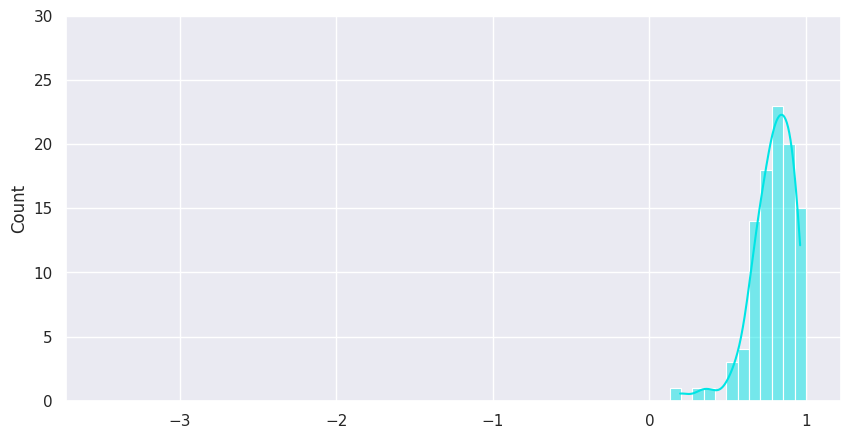



mean rmse: 0.08612315090812576
rmse std. dev.: 0.027474723740867426
rmse distribution:


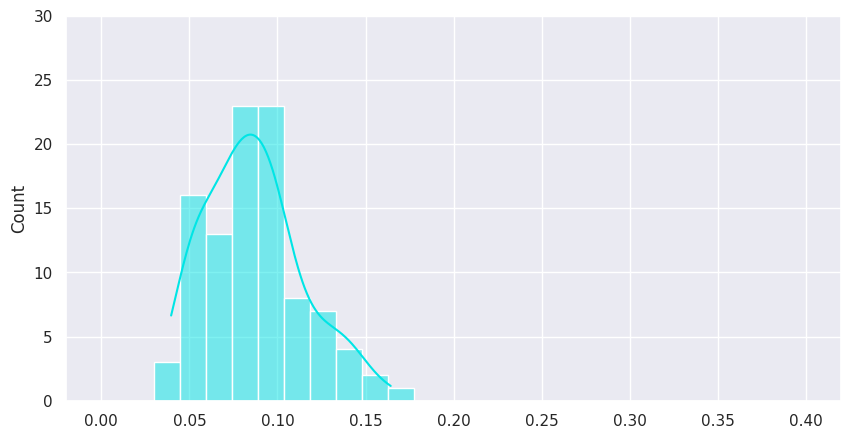

In [ ]:
repeated_samples_stats(r2_test_list_blend, rmse_test_list_blend, '#00E5E5')

In [ ]:
compare_samples_stats(r2_test_list_blend, rmse_test_list_blend)

change in r2 mean: 0.2364312081659803
change in r2 std. dev: -0.814962170780387
t-test for r2: TtestResult(statistic=2.009131838021211, pvalue=0.04707050302171245, df=105.77138349815507)
levene test for r2: LeveneResult(statistic=4.96606315762877, pvalue=0.026974172005517338)


change in rmse mean: -0.06579485490610627
change in rmse std. dev: -0.5739548388494747
t-test for rmse: TtestResult(statistic=-0.8653112858017421, pvalue=0.38841686968049394, df=133.79350760150777)
levene test for rmse: LeveneResult(statistic=3.3802665625728916, pvalue=0.0674793353115188)


In [ ]:
compare_samples_stats(r2_test_list_blend, rmse_test_list_blend, r2_test_list_combined, rmse_test_list_combined)

change in r2 mean: -0.023248983168067495
change in r2 std. dev: -0.09911966285086989
t-test for r2: TtestResult(statistic=-0.9199862108203173, pvalue=0.35871152626224667, df=195.88113066404168)
levene test for r2: LeveneResult(statistic=0.5865002751475361, pvalue=0.4446876208133481)


change in rmse mean: 0.09139291444209026
change in rmse std. dev: -0.07972549775995347
t-test for rmse: TtestResult(statistic=1.7775141443818299, pvalue=0.07702923536907144, df=196.64878892411997)
levene test for rmse: LeveneResult(statistic=0.5136358814578932, pvalue=0.4744136428854119)


## specific case examples

this section shows the individual time series curves for real and predicted for selected experiments.

In [ ]:
lineplot_colors = {'real': colors.to_rgb('#3B8C6E'),
                   'pred': colors.to_rgb('#dba95d')}

def example_set(df: pd.DataFrame, train_list: list, test_list: list):
  train = df[df.sample_num.isin(train_list)]
  test = df[df.sample_num.isin(test_list)]

  X_train_cross = train[['temp', 'pH', 'redox', 'capac']]
  y_train_cross = train['ethn']

  X_test_cross = test[['temp', 'pH', 'redox', 'capac']]
  y_test_cross = test['ethn']

  model2_fold = Sequential([
    Dense(80, activation = 'relu'),
    Dense(60, activation = 'relu'),
    Dense(1)
  ])

  model2_fold.compile(
    loss = keras.losses.MeanSquaredError(),
    optimizer=tf.keras.optimizers.Adam(0.01),
    metrics=['mean_squared_error'])

  history_fold = model2_fold.fit(X_train_cross, y_train_cross, epochs = 100, batch_size = 1024, validation_data = (X_test_cross, y_test_cross), verbose = 0)

  train_r2, test_r2 = rsquare(model2_fold, X_train_cross, X_test_cross, y_train_cross, y_test_cross)
  train_rmse, test_rmse = calc_rmse(model2_fold, X_train_cross, X_test_cross, y_train_cross, y_test_cross)

  case_pred = model2_fold.predict(X_test_cross)

  case_array = pd.concat((pd.DataFrame(case_pred), pd.DataFrame(test['ethn']).reset_index(drop=True), pd.DataFrame(np.tile(np.arange(500), 1), columns = ['time'])), axis = 1)
  case_array.columns = ['pred', 'real', 'time']
  case_array_fixed = pd.melt(case_array, value_vars=['pred', 'real'], id_vars=['time'], value_name='ethn', var_name = 'type')

  sns.lineplot(data=case_array_fixed, x="time", y="ethn", hue='type', palette = lineplot_colors)

### experiment 8 (noisy capacitance sensor)

16/16 [==============================] - 0s 2ms/step
train r-square: 0.96
test r-square: -0.56
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03881
test rmse: 0.22881
16/16 [==============================] - 0s 2ms/step


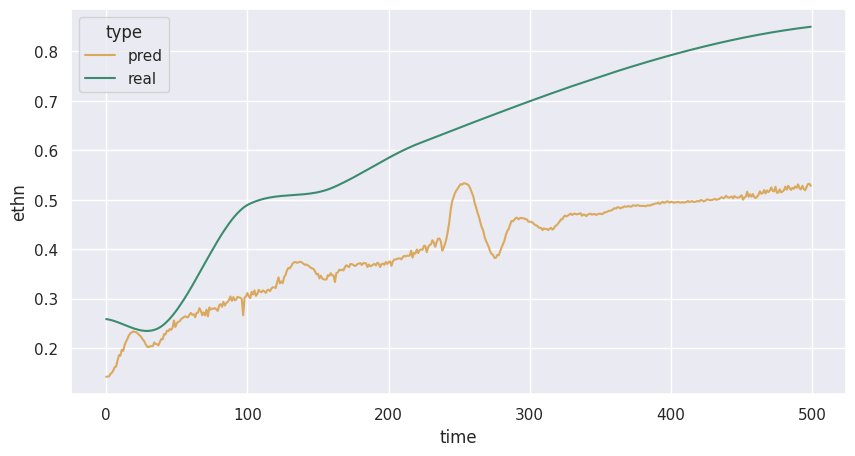

In [ ]:
# original model
example_set(original_flat_scaled, [0,1,2,3,4,5,6,7,9,10], [8])

16/16 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: 0.81
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02184
test rmse: 0.08042
16/16 [==============================] - 0s 2ms/step


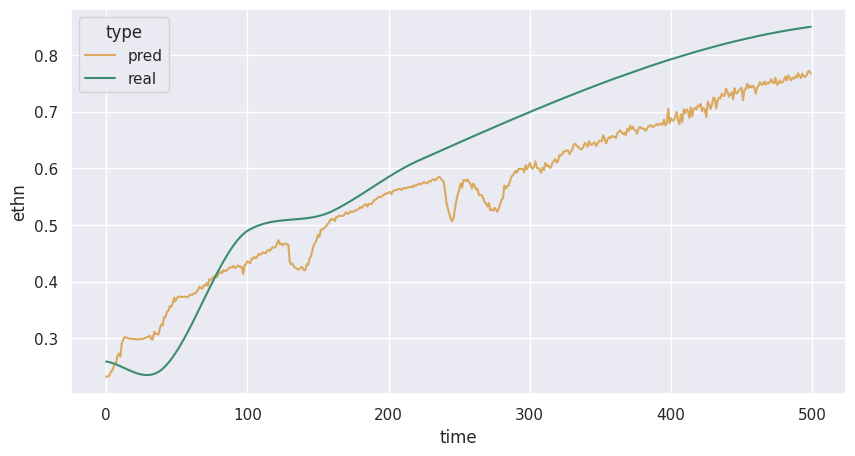

In [ ]:
# synthetic model (20 sets)
example_set(vae_plus_orig, random.sample(range(11,111), 20), [8])

16/16 [==============================] - 0s 2ms/step
train r-square: 0.98
test r-square: 0.98
16/16 [==============================] - 0s 2ms/step
train rmse: 0.01844
test rmse: 0.02552
16/16 [==============================] - 0s 2ms/step


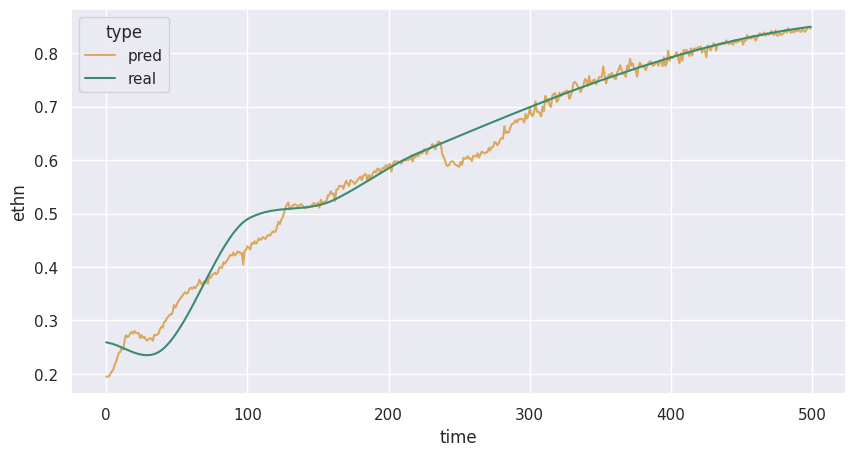

In [ ]:
# synthetic model (100 sets)
example_set(vae_plus_orig, range(11,111), [8])

16/16 [==============================] - 0s 3ms/step
train r-square: 0.95
test r-square: 0.54
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03949
test rmse: 0.12398
16/16 [==============================] - 0s 2ms/step


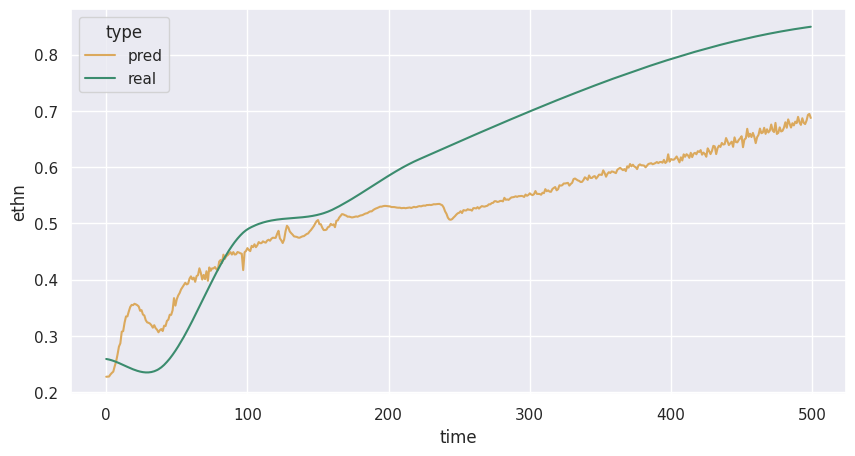

In [ ]:
# blend model
example_set(vae_plus_orig, random.sample(range(11,111), 10) + [0,1,2,3,4,5,6,7,9,10], [8])

### experiment 3

16/16 [==============================] - 0s 2ms/step
train r-square: 0.95
test r-square: 0.61
16/16 [==============================] - 0s 2ms/step
train rmse: 0.04559
test rmse: 0.12789
16/16 [==============================] - 0s 2ms/step


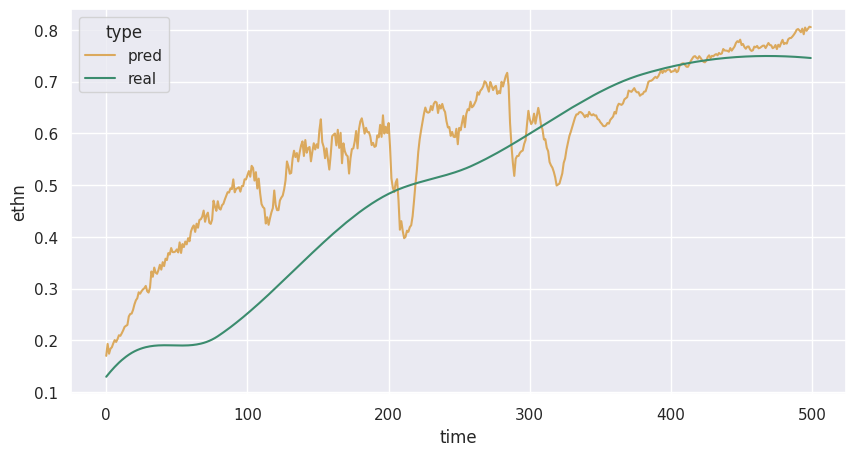

In [ ]:
# original model
example_set(original_flat_scaled, [0,1,2,4,5,6,7,8,9,10], [3])

16/16 [==============================] - 0s 4ms/step
train r-square: 0.98
test r-square: 0.70
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02120
test rmse: 0.11182
16/16 [==============================] - 0s 2ms/step


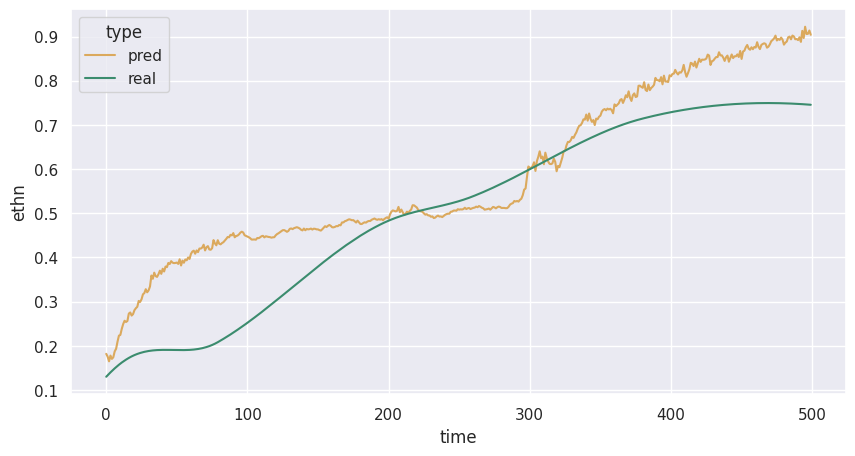

In [ ]:
# synthetic model (20 set)
example_set(vae_plus_orig, random.sample(range(11,111),20), [3])

16/16 [==============================] - 0s 2ms/step
train r-square: 0.98
test r-square: 0.80
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02023
test rmse: 0.09267
16/16 [==============================] - 0s 2ms/step


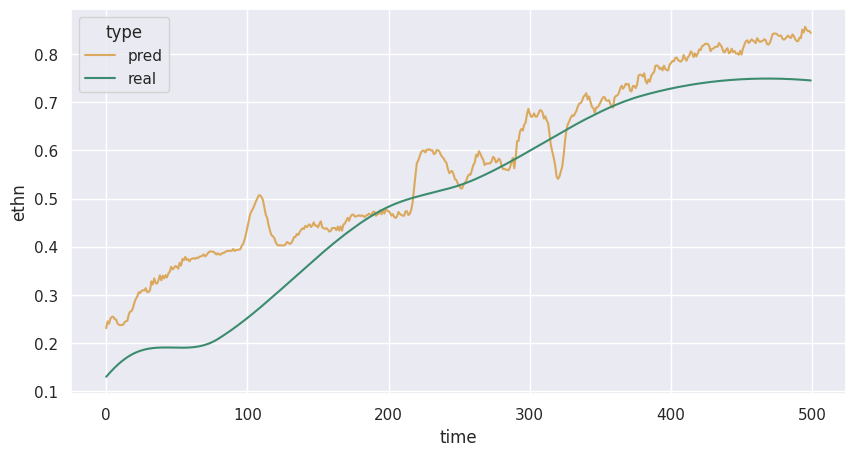

In [ ]:
# synthetic model (100 sets)
example_set(vae_plus_orig, range(11,111), [3])

16/16 [==============================] - 0s 3ms/step
train r-square: 0.96
test r-square: 0.74
16/16 [==============================] - 0s 3ms/step
train rmse: 0.03496
test rmse: 0.10452
16/16 [==============================] - 0s 3ms/step


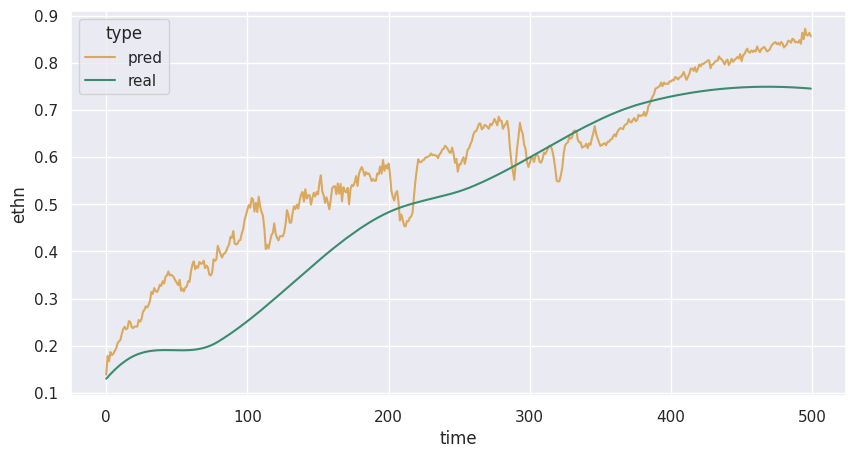

In [ ]:
# blend model
example_set(vae_plus_orig, random.sample(range(11,111),10) + [0,1,2,4,5,6,7,8,9,10], [3])

### experiment 0

16/16 [==============================] - 0s 2ms/step
train r-square: 0.95
test r-square: 0.80
16/16 [==============================] - 0s 2ms/step
train rmse: 0.04258
test rmse: 0.09222
16/16 [==============================] - 0s 2ms/step


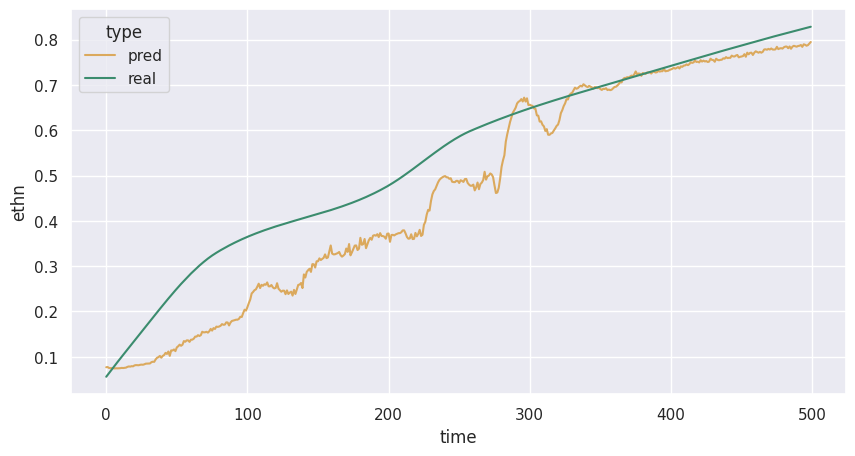

In [ ]:
# original model
example_set(original_flat_scaled, [3,1,2,4,5,6,7,8,9,10], [0])

16/16 [==============================] - 0s 3ms/step
train r-square: 0.96
test r-square: 0.95
16/16 [==============================] - 0s 2ms/step
train rmse: 0.02508
test rmse: 0.04681
16/16 [==============================] - 0s 2ms/step


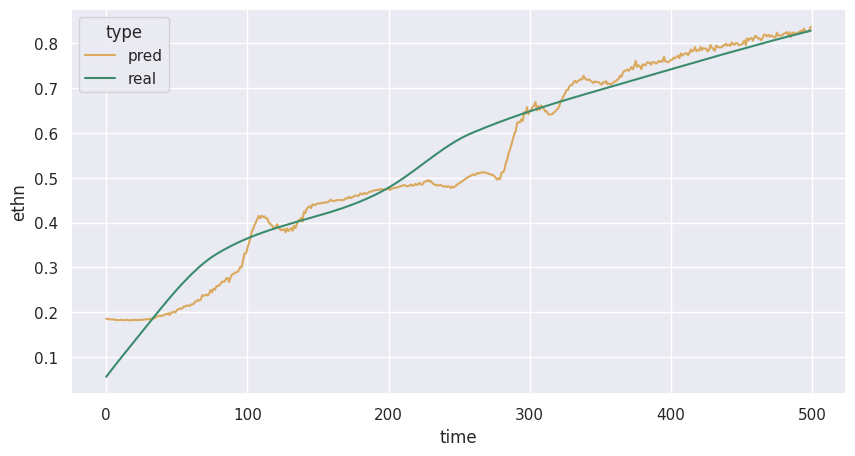

In [ ]:
# synthetic model (20 set)
example_set(vae_plus_orig, random.sample(range(11,111),20), [0])

16/16 [==============================] - 0s 2ms/step
train r-square: 0.98
test r-square: 0.96
16/16 [==============================] - 0s 3ms/step
train rmse: 0.01889
test rmse: 0.03878
16/16 [==============================] - 0s 2ms/step


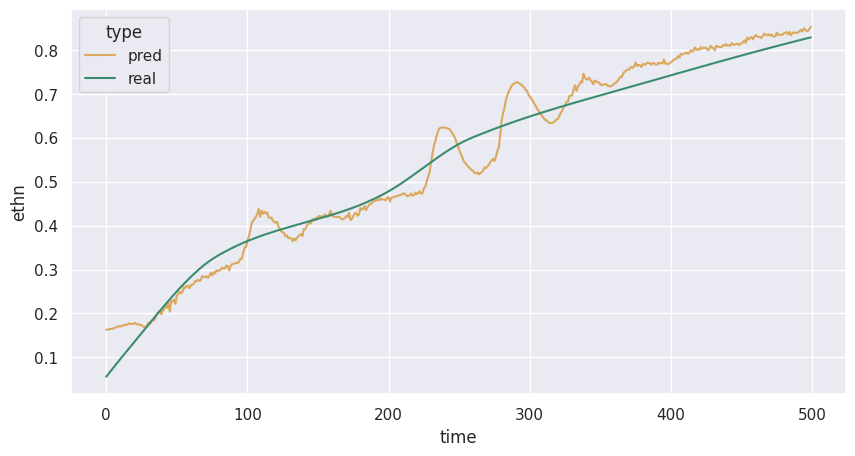

In [ ]:
# synthetic model (100 set)
example_set(vae_plus_orig, range(11,111), [0])

16/16 [==============================] - 0s 2ms/step
train r-square: 0.97
test r-square: 0.81
16/16 [==============================] - 0s 2ms/step
train rmse: 0.03056
test rmse: 0.08791
16/16 [==============================] - 0s 1ms/step


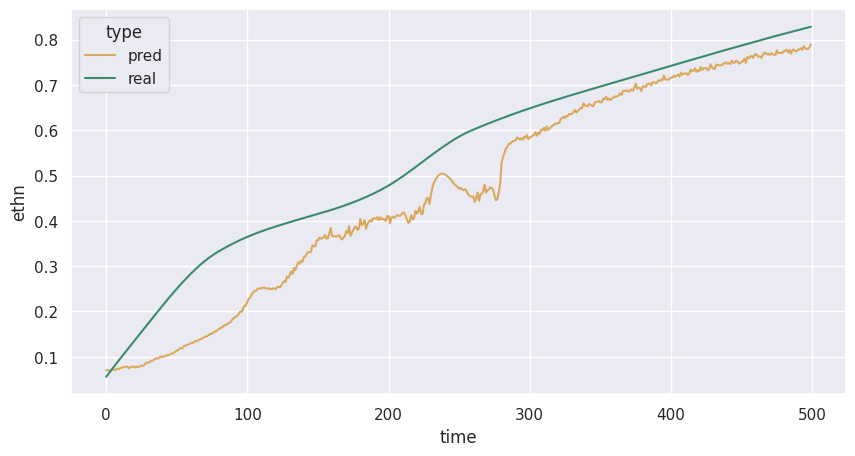

In [ ]:
# blend model
example_set(vae_plus_orig, random.sample(range(11,111),10) + [1,2,3,4,5,6,7,8,9,10], [0])